In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
from scipy import signal
from  scipy.io import wavfile
import librosa
import librosa.display
from IPython import display
from copy import deepcopy

# the pra library
import pyroomacoustics as pra

In [2]:
# A simple wrapper class for (1-channel) audio data
# data is a 1-D NumPy array containing the data
# rate is a number expressing the samples per second
class Audio:
    def __init__(self, data, rate):
        self.data = data
        self.rate = rate
    def play(self):
        return display.Audio(self.data, rate=self.rate)
    def plot_wave(self):
        librosa.display.waveplot(self.data, sr=self.rate)
    def plot_spectrum(self):
        n_fft = int(self.rate / 20)
        D = librosa.amplitude_to_db(np.abs(librosa.stft(self.data, n_fft)), ref=np.max)
        librosa.display.specshow(D, y_axis='linear', sr=self.rate, hop_length=n_fft/4)
    @classmethod
    def fromfile(cls, fn):
        return cls(*librosa.load(fn, sr=None))

# Load Sound

In [3]:
flute = Audio.fromfile("./sounds/flute.wav")
flute.play()

In [4]:
background = Audio.fromfile("./sounds/background_noise.wav")
background = Audio(background.data[:len(flute.data)], background.rate)
background.play()

In [5]:
silence = Audio(np.asarray([0.0] * len(flute.data)), flute.rate)
silence.play()

/Users/mac/opt/anaconda3/envs/py3.8/lib/python3.8/site-packages/IPython/lib/display.py:174: RuntimeWarning: invalid value encountered in true_divide
  scaled = data / normalization_factor * 32767


# Beamforming

In [6]:
def beamforming(sound, noise):
    '''Room Parameters and Room Creation'''
    rt60 = 0.5
    room_dim = [10, 10, 10] # meters
    e_absorption, max_order = pra.inverse_sabine(rt60, room_dim)
    # m = pra.Material(energy_absorption="panel_fabric_covered_6pcf")
    room = pra.ShoeBox(room_dim, fs=48000, materials=pra.Material(e_absorption), max_order=0) #simulate perfect situation: no reflections

    '''Sound Source Creation'''
    room.add_source([7, 1, 2], signal=sound)
    room.add_source([8, 5, 5], signal=noise)

    '''Mic Array Creation'''
    mic_locs = np.c_[
        [1, 4.5, 5],
#         [1, 4.6, 5],
        [1, 4.7, 5],
#         [1, 4.8, 5],
        [1, 4.9, 5],
#         [1, 5, 5],
        [1, 5.1, 5],
#         [1, 5.2, 5],
        [1, 5.3, 5],
#         [1, 5.4, 5],
        [1, 5.5, 5]
    ]

    # filter size
    Lg_t = 0.1 # filter size in seconds
    Lg = np.ceil(Lg_t*room.fs)

    # place the beamforming micarray in the room (the beamforming class is a child class of the micarray class)
    fft_len = 512
    mics = pra.Beamformer(mic_locs, room.fs, N=fft_len, Lg=Lg)
    room.add_microphone_array(mics)

    # Compute DAS (delay and sum) weights
    mics.rake_delay_and_sum_weights(room.sources[0])

    '''Simulation'''
    room.compute_rir()
    room.simulate()
    return room, mics

# Evaluation

## 3. Flute vs. BackgroundNoise

/Users/mac/opt/anaconda3/envs/py3.8/lib/python3.8/site-packages/pyroomacoustics/room.py:1525: MatplotlibDeprecationWarning: Axes3D(fig) adding itself to the figure is deprecated since 3.4. Pass the keyword argument auto_add_to_figure=False and use fig.add_axes(ax) to suppress this warning. The default value of auto_add_to_figure will change to False in mpl3.5 and True values will no longer work in 3.6.  This is consistent with other Axes classes.
  ax = a3.Axes3D(fig)


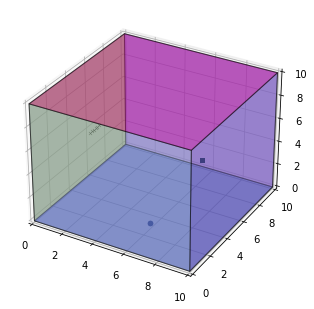

In [7]:
room, mics = beamforming(flute.data, background.data)
fig, ax = room.plot()

### a. Perception Evaluation

In [8]:
### Original_mixed ###
mix_audio = Audio(room.mic_array.signals[0, :], room.fs)
mix_audio.play()

In [9]:
### Beamformed ###
bf_signal = mics.process()
bf_audio = Audio(bf_signal * np.linalg.norm(mix_audio.data) / np.linalg.norm(bf_signal.data), room.fs)
# bf_audio = Audio(bf_signal, room.fs)
bf_audio.play()

### b. Compare the Waveplots and Spectra

#### Waveplots

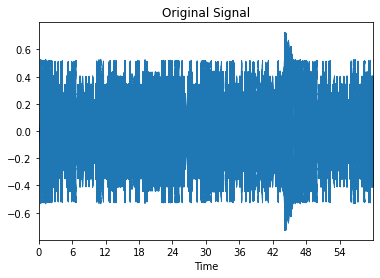

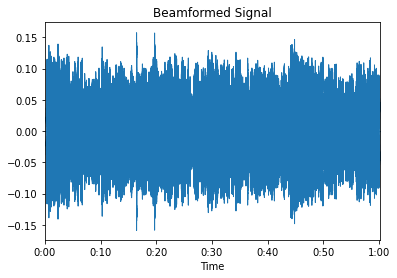

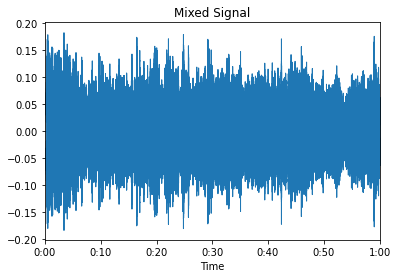

In [12]:
fig, ax = plt.subplots()
flute.plot_wave()
ax.set(title='Original Signal')

fig, ax = plt.subplots()
bf_audio.plot_wave()
ax.set(title='Beamformed Signal')

fig, ax = plt.subplots()
mix_audio.plot_wave()
ax.set(title='Mixed Signal')

plt.show()

#### Spectragram

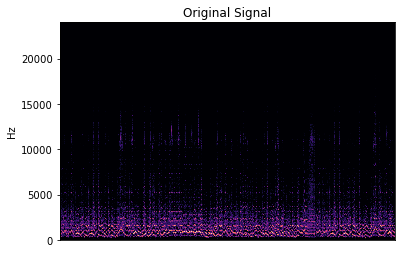

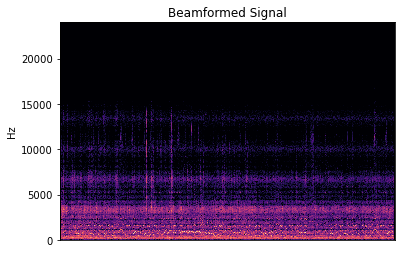

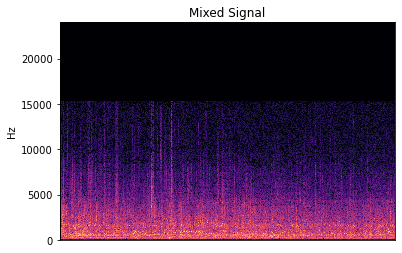

In [13]:
fig, ax = plt.subplots()
flute.plot_spectrum()
ax.set(title='Original Signal')

fig, ax = plt.subplots()
bf_audio.plot_spectrum()
ax.set(title='Beamformed Signal')

fig, ax = plt.subplots()
mix_audio.plot_spectrum()
ax.set(title='Mixed Signal')

plt.show()

### c. Signal-to-Ration (SNR) Analysis

In [14]:
def SNR(signal,noise):
    snr = 10 * np.log10(np.mean(np.asarray(signal)**2) / np.mean(np.asarray(noise)**2))
    return snr

In [17]:
# construct beamformed data --> signal
room, mics = beamforming(flute.data, silence.data)
recv_flute = Audio(room.mic_array.signals[0, :], room.fs)
construct_flute = mics.process() # constructed beamformed data

In [18]:
# deconstructed beamformed data --> noise
room, mics = beamforming(silence.data, background.data)
recv_background = Audio(room.mic_array.signals[0, :], room.fs)
deconstruct_noise = mics.process() # deconstructed beamformed data

In [19]:
snr1 = SNR(recv_flute.data,recv_background.data)
print("Mixed-Signal SNR:", snr1)

snr2 = SNR(construct_flute,deconstruct_noise)
print("Beamformed-Signal SNR:", snr2)

Mixed-Signal SNR: -0.4932128729114805
Beamformed-Signal SNR: 7.75183530900774
